#  1.Detección de carril en una imagen Fija

<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

En este notebook analizaremos como realizar la detección de carriles en una imagen Utilizando OpenCV. Nuestro objetivo de Aplicacion es poder tener una camara en el vehiculo que capture la imagen de la via por donde circula el vehiculo y poder realizar la detección de carril en esta imagen. Aqui aprenderemos aplicar las transformadas de Hough ycomo aplicarlas en el uso de deteccion de carriles en una imagen fija. Los puntos Analizar son los siguientes:

* Crear un Umbral para las lineas de carril 
* Seleccionar las regiones de Interes 
* Detección de Bordes usando Canny Edge Detector 
* Ajustar lineas usando Hough Line Transform
* Extrapolar los carriles a partir de las lineas encontradas
* Componer el cuadro original resultante 

<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

## 1.1 Crear un umbral para las lineas del carril 
<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />


El primer paso en nuestro flujo de trabajo es construir un umbral general que aisle las lineas de los carriles. En un pricipio el umbral abarcara toda la imagen, luego aislaremos la zona de interes, por el momento no necesitamos preocupoarnos por el cielo, los arboles o las montañas 

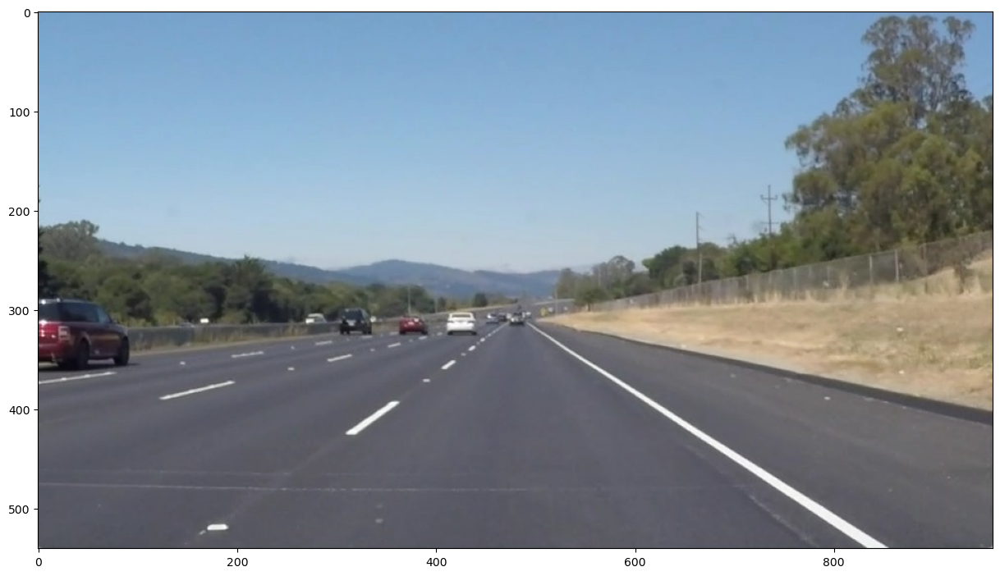

In [13]:
import matplotlib.pyplot as plt
import numpy as np 
import cv2 as cv 

# leyendo la Imagen
img = cv.imread("./img/test_img.jpg")
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
plt.figure(figsize=(15,10))
plt.imshow(img)

## cv2.inRange en Umbralización
<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

La función `cv2.inRange` se utiliza para extraer una parte de la imagen que se encuentra dentro de un rango específico de colores.

### Sintaxis
```python
cv2.inRange(imagen, limite_inferior, limite_superior)
```

Donde:
    
* imagen: La imagen de origen en la que se busca el rango de colores.
* limite_inferior: El límite inferior del rango de colores que se desea extraer, en formato de lista o tupla (B, G, R).
* limite_superior: El límite superior del rango de colores que se desea extraer, en formato de lista o tupla (B, G, R).
    

 En nuestra aplicación nuestro rango estara especificado dentro de los valores de una imagen en escala de grises(0-255)
 por lo tanto la función nos devuelve una imagen binaria donde los píxeles que caen dentro del rango especificado se establecen en 255 (blanco), y los que están fuera del rango se establecen en 0 (negro).
 
 A continuación el Ejemplo:

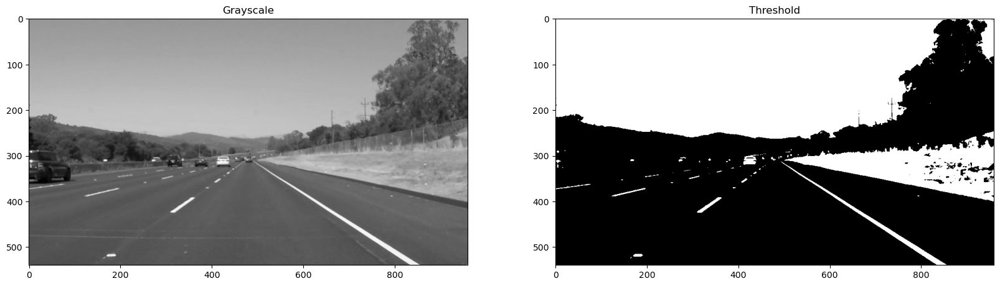

In [14]:
# Conversion a Escala de Grises
img_gray = cv.cvtColor(img, cv.COLOR_RGB2GRAY)

# Usamos un Umbral global basado en la intensidad de la escala de grises
threshold = cv.inRange(img_gray, 150, 255)

# Mostrando Imagenes 
plt.figure(figsize=(20,10))
plt.subplot(1,2,1), plt.imshow(img_gray, cmap="gray"), plt.title("Grayscale")
plt.subplot(1,2,2), plt.imshow(threshold, cmap="gray"), plt.title("Threshold")
plt.show()



## 1.2 Seleccionar la región de interés usando fillPoly()

Podemos observar que es un trapezoide.

<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

La función `fillPoly()` rellena el área delimitada por uno o más polígonos.

### <font style="color:rgb(8,133,37)">Sintaxis de función</font>
``` pitón
dst = cv2.fillPoly( img, pts, color[, lineType[, shift[, offset]]] )
```

Donde:

`dst`: Es la imagen de salida del mismo tamaño y profundidad que `img`.

La función tiene **2 argumentos de entrada obligatorios** y 4 argumentos opcionales:

1. `img`: Imagen de entrada.
2. `pts`: Conjunto de polígonos donde cada polígono se representa como un conjunto de puntos.
3. `color`: Color del polígono.
4. `lineType`: Tipo de límites del polígono.
5. `shift`: Número de bits fraccionarios en las coordenadas del vértice.
6. `offset`: Desplazamiento opcional de todos los puntos de los contornos.

<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

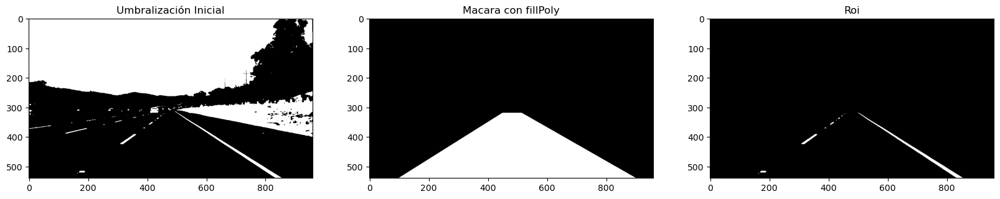

In [15]:
# Macara de la Region: Seleccionamos los vertices accorde a la imagen de entrada

roi_vertices = np.array([[[100, 540],
                          [900, 540],
                          [515, 320],
                          [450, 320]]])

# definimos una mascara en blanco
mascara = np.zeros_like(threshold)

# Definir un color de 3 canales o 1 canal para llenar la máscara.
if len(threshold.shape)>2:
    cantidad_canales = threshold.shape[2]  # el indice puede ser 3 o 4 dependiento la iamgen 
    mask_color_quitar = (255,) * cantidad_canales
else:
    mask_color_quitar = 255
#Rellenar píxeles dentro del polígono.

cv.fillPoly(mascara, roi_vertices, mask_color_quitar)

# Construir la región de interés en función de dónde los píxeles de la máscara son distintos de cero.
roi = cv.bitwise_and(threshold, mascara)
    
# Mostramos las Imagenes.
plt.figure(figsize = (20, 10))
plt.subplot(1,3,1); plt.imshow(threshold, cmap = 'gray'); plt.title('Umbralización Inicial')
plt.subplot(1,3,2); plt.imshow(mascara, cmap = 'gray');      plt.title('Macara con fillPoly')
plt.subplot(1,3,3); plt.imshow(roi, cmap = 'gray');       plt.title("Roi");

## 1.3 Detectar bordes y suavizar el ruido
<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

A continuación necesitamos identificar los bordes de la imagen. Podemos usar la detección de bordes de Canny para identificar las líneas de los carriles, seguida de un desenfoque gaussiano para suavizar cualquier ruido restante después de la detección de bordes.

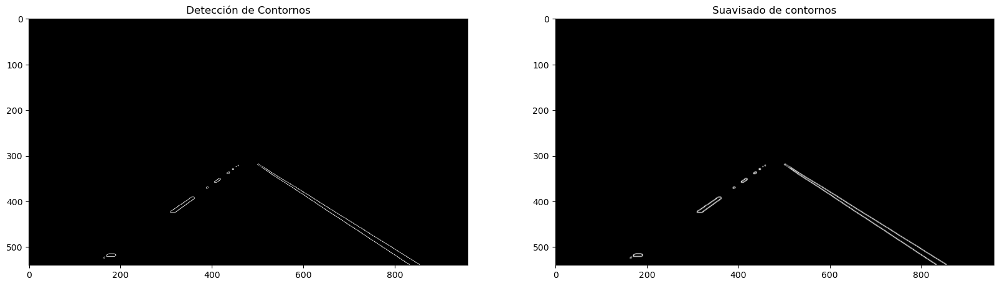

In [16]:
umbral_bajo = 50
umbral_alto = 100
contornos = cv.Canny(roi, umbral_bajo, umbral_alto)

# Suavisar con un desenfoque gausiano
kernel_size = 3
canny_blur = cv.GaussianBlur(contornos, (kernel_size, kernel_size), 0)

# Mostrar Imagenes.
plt.figure(figsize = (20, 10))
plt.subplot(1,2,1); plt.imshow(contornos, cmap = 'gray'); plt.title('Detección de Contornos')
plt.subplot(1,2,2); plt.imshow(canny_blur, cmap = 'gray'); plt.title('Suavisado de contornos');
plt.show()


## 1.4 Detección de líneas usando HoughLinesP()

<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

`HoughLinesP()` encuentra segmentos de línea en una imagen binaria usando la transformada probabilística de Hough. La función implementa el algoritmo probabilístico de transformada de Hough para la detección de líneas.

### <font style="color:rgb(8,133,37)">Sintaxis</font>
``` python
líneas = cv2.HoughLinesP(imagen, rho, theta, umbral[, líneas[, minLineLength[, maxLineGap]]])
```
`lineas`: Vector de salida de líneas. Cada línea está representada por un vector de 4 elementos (x1,y1,x2,y2), donde (x1,y1) y (x2,y2) son los puntos finales de cada segmento de línea detectado.

La función tiene **4 argumentos de entrada requeridos**:

1. `image`: imagen fuente binaria de un solo canal y 8 bits.
2. `rho`: Resolución de distancia del acumulador en píxeles.
3. `theta`: Resolución del ángulo del acumulador en radianes.
4. `umbral`: devuelve solo aquellas líneas que son mayores que el umbral.
5. `minLineLength`: longitud mínima de línea. Los segmentos de línea más cortos que eso se rechazan.
6. `maxLineGap`: Espacio máximo permitido entre puntos de una misma línea para vincularlos.

<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

In [17]:
# Creamos una función para graficar las lineas 
def draw_lines(img, lineas, color=[255,0,0],thickness=2):
    
    if lineas is not None:
        for linea in lineas:
            for x1,y1,x2,y2 in linea:
                cv.line(img,(x1,y1),(x2,y2), color, thickness)
                


Numero de lineas en contradas:21, incluidas[[500 318 853 539]]


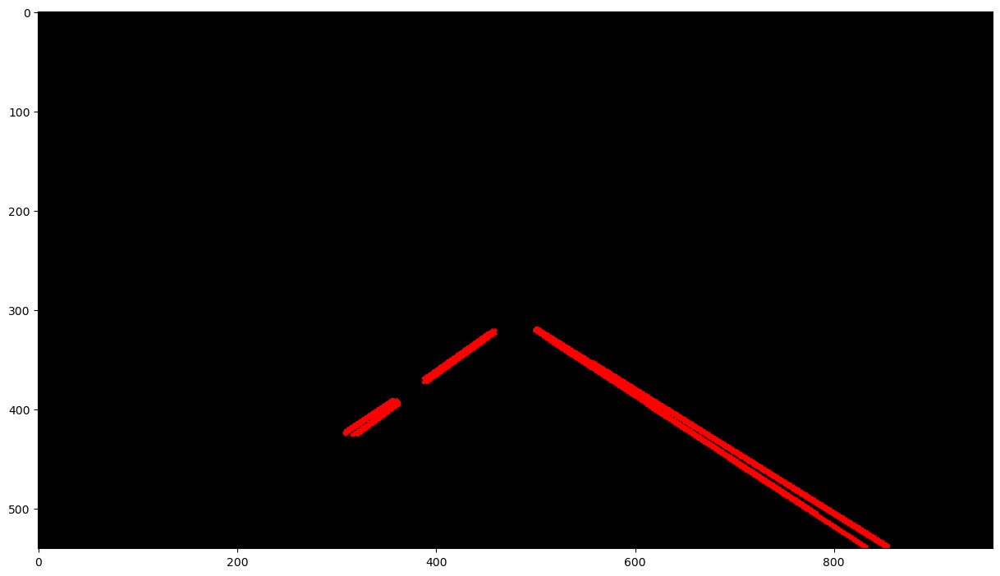

In [18]:
# Configuramos los parametros para la entrada de la función HoughsLinesP acorde a nuestra imagene de entrada
rho = 1
theta = np.pi / 180
threshold = 50
min_line_len = 10
max_line_gap = 20

lineas = cv.HoughLinesP(canny_blur, 
                        rho, 
                        theta, 
                        threshold, 
                        minLineLength = min_line_len, 
                        maxLineGap = max_line_gap)

# Dibujamos todas las linea encontradas en la imagen  en una nueva imagen 
img_hough = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
draw_lines(img_hough, lineas)

print(f"Numero de lineas en contradas:{len(lineas)}, incluidas{lineas[0]}")
plt.figure(figsize = (15, 10))
plt.imshow(img_hough)
plt.show()


## 1.5 Separar lados y extrapolar

<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

### <font style='color:rgb(50,70,250)'> 5.1 Función para separar líneas de izquierda y derecha según la pendiente </font>

Necesitamos observar todas las líneas y determinar si contribuyen a las líneas del carril izquierdo o derecho. A medida que las coordenadas y aumentan de valor de arriba a abajo, una línea con pendiente positiva es parte del carril derecho y una pendiente negativa significa el carril izquierdo. Por lo tanto, si `y1 > y2` tenemos carril izquierdo, y si `y1 < y2` tenemos carril derecho.

In [19]:
def separando_izquierda_derecha(lineas):
    """ Separamos las lineas izquierda y derecha dependeindo de la pendiente"""
    lineas_izquierda = []
    lineas_derecha = []
    if lineas is not None:
        for linea in lineas:
            for x1,y1,x2,y2 in linea:
                # Si la cordenada y1 es mayor que y2 la pendiente es positiva y pertenece al lado izquierdo
                if y1>y2:
                    lineas_izquierda.append([x1,y1,x2,y2])
                # Si la cordenada y1 es menor que y2 la pendiente es negativa y pertenece al lado derecho
                elif y1<y2:
                    lineas_derecha.append([x1,y1,x2,y2])
                    
    return lineas_izquierda,lineas_derecha
    

### <font style='color:rgb(50,70,250)'> 5.2 Función para calcular el promedio que se utilizará en la extrapolación de líneas </font>

In [20]:
def cal_promedio(valores):
    """Calcula el valor promedio."""
    if not (type(valores) == 'NoneType'):
        if len(valores) > 0:
            n = len(valores)
        else:
            n = 1
        return sum(valores)/n

### <font style='color:rgb(50,70,250)'> 5.3 Función para extrapolar líneas </font>

Ya que algunas líneas de carril sólo se reconocen parcialmente. Deberíamos extrapolar la línea para cubrir la longitud completa del carril.
Debemos tener en cuenta las intersecciones de los límites inferior y superior para encontrar la longitud total de la línea del carril.

In [21]:
def extrapolar_lineas(lineas, borde_superior, borde_inferior):
    """Extrapolar líneas teniendo en cuenta las intersecciones de los bordes inferior y superior"""
    pendientes = [] #pendientes de cada linea
    consts = []   # constantes de la formula de pendiente en cada linea 
    if lineas is not None:
        for x1,y1,x2,y2 in lineas:
            pendiente = (y1-y2)/(x1-x2)
            pendientes.append(pendiente)
            c = y1-pendiente*x1
            consts.append(c)
        
    prom_pendiente = cal_promedio(pendientes)
    prom_constantes = cal_promedio(consts)
    
    # Calcular la intersección promedio en el borde inferior
    x_punto_bajo_carril = int((borde_inferior - prom_constantes)/prom_pendiente)
    
    # Calcular la intersección promedio en el borde_superior
    x_punto_superior_carril = int((borde_superior - prom_constantes)/prom_pendiente)
    
    return [x_punto_bajo_carril, borde_inferior, x_punto_superior_carril, borde_superior]
    

### <font style='color:rgb(50,70,250)'> 5.4 Extraer carriles extrapolados y dibujar líneas de carril </font>

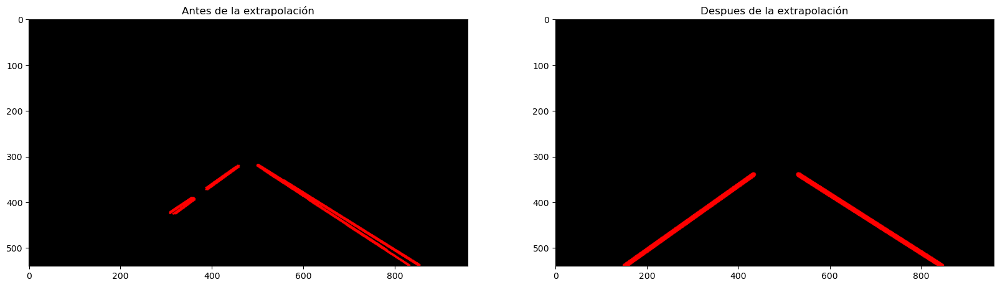

In [22]:
# Definir los límites de la región de interés.
roi_borde_superior = 340
roi_borde_inferior = 540

# Crea una matriz en blanco para contener los resultados (coloreados)
lineas_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)

# Utilice la función definida anteriormente para identificar listas de líneas del lado izquierdo y derecho.
lineas_izquierda, lineas_derecha = separando_izquierda_derecha(lineas)

# Utilice la función definida anteriormente para extrapolar las listas de líneas a carriles reconocidos.
linea_izquierda = extrapolar_lineas(lineas_izquierda, roi_borde_superior, roi_borde_inferior)
linea_derecha = extrapolar_lineas(lineas_derecha, roi_borde_superior, roi_borde_inferior)

draw_lines(lineas_img, [[linea_izquierda]], thickness=10)
draw_lines(lineas_img, [[linea_derecha]], thickness=10)

# Mostrando Resultados
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(1,2,1); plt.imshow(img_hough); ax.set_title("Antes de la extrapolación")
ax = fig.add_subplot(1,2,2); plt.imshow(lineas_img), ax.set_title("Despues de la extrapolación")
plt.show()



## 1.6 Combine los resultados
<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

Como paso final, podemos combinar los carriles detectados con la imagen original de la carretera.

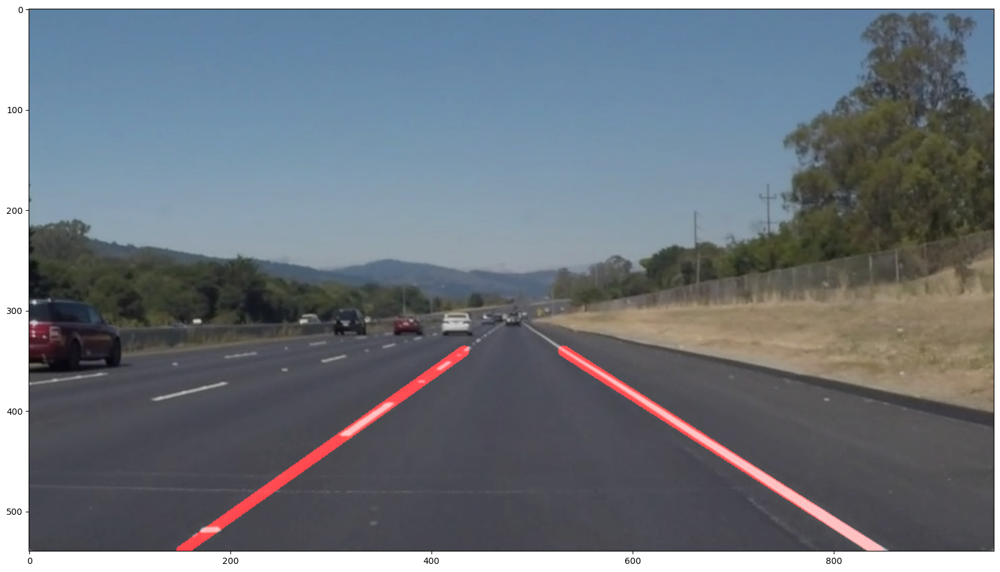

In [23]:
alpha = 0.8
beta = 1.0
gamma = 0.0
image_final = cv.addWeighted(img, alpha, lineas_img, beta, gamma)

# Display the results, and save image to file.
fig = plt.figure(figsize = (20, 20))
plt.imshow(image_final)
image_final = cv.cvtColor(image_final, cv.COLOR_BGR2RGB)
cv.imwrite('./img/imagen_final.jpg', image_final);

# 2.0  Detección de Carril en Video

<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />
Con lo visto anteriormente realizaremos un detector de carril en un video utilizando OpenCV. Anteriormente miramos como detectar un carril en una imagen. Ahora miraremos como detectar un un carril en un video.

In [24]:
import numpy as np 
import cv2 as cv 
from moviepy.editor import *

clip_video = VideoFileClip("lane1-straight.mp4")
clip_video.ipython_display()

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


## 2.1 Definir funciones analizadas en la detección de carril en una imagen
<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

 A continuación definiremos cada uno de los procesos realizados anteriormente y los separaremos por funciones.

In [25]:
# Creamos la funcion que nos permite separar nuestra region de interes del resto de la imagen
def region_de_interes(img,vertices):
    # definimos una mascara en blanco
    mascara = np.zeros_like(img)

    # Definir un color de 3 canales o 1 canal para llenar la máscara.
    if len(img.shape)>2:
        cantidad_canales = img.shape[2]  # el indice puede ser 3 o 4 dependiento la iamgen 
        mask_color_quitar = (255,) * cantidad_canales
    else:
        mask_color_quitar = 255
    #Rellenar píxeles dentro del polígono.

    cv.fillPoly(mascara, vertices, mask_color_quitar)

    # Construir la región de interés en función de dónde los píxeles de la máscara son distintos de cero.
    imagen_enmascarada = cv.bitwise_and(img, mascara)
    return imagen_enmascarada

In [26]:
# Creamos una función para graficar las lineas 
def draw_lines(img, lineas, color=[255,0,0],thickness=2):
    
    if lineas is not None:
        for linea in lineas:
            for x1,y1,x2,y2 in linea:
                cv.line(img,(x1,y1),(x2,y2), color, thickness)

In [27]:
# Creamos la funcion para el calculo de las lineas con hough
def hough_lineas(img, rho, theta, threshold, min_line_len, max_line_gap):
    lineas = cv.HoughLinesP(img, 
                            rho, 
                            theta, 
                            threshold, 
                            minLineLength = min_line_len, 
                            maxLineGap = max_line_gap)

    # Dibujamos todas las linea encontradas en la imagen  en una nueva imagen 
    img_hough = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    draw_lines(img_hough, lineas)
    return img_hough, lineas


In [28]:
# funcion para separar las lineas de izquierda y derecha del carril

def separando_izquierda_derecha(lineas):
    """ Separamos las lineas izquierda y derecha dependeindo de la pendiente"""
    lineas_izquierda = []
    lineas_derecha = []
    if lineas is not None:
        for linea in lineas:
            for x1,y1,x2,y2 in linea:
                # Si la cordenada y1 es mayor que y2 la pendiente es positiva y pertenece al lado izquierdo
                if y1>y2:
                    lineas_izquierda.append([x1,y1,x2,y2])
                # Si la cordenada y1 es menor que y2 la pendiente es negativa y pertenece al lado derecho
                elif y1<y2:
                    lineas_derecha.append([x1,y1,x2,y2])
                    
    return lineas_izquierda,lineas_derecha

In [29]:
# Funcion para calcular el promedio 
def cal_promedio(valores):
    """Calcula el valor promedio."""
    if not (type(valores) == 'NoneType'):
        if len(valores) > 0:
            n = len(valores)
        else:
            n = 1
        return sum(valores)/n

In [30]:
# Funcion para extrapòlar las lineas
def extrapolar_lineas(lineas, borde_superior, borde_inferior):
    """Extrapolar líneas teniendo en cuenta las intersecciones de los bordes inferior y superior"""
    pendientes = [] #pendientes de cada linea
    consts = []   # constantes de la formula de pendiente en cada linea 
    if lineas is not None:
        for x1,y1,x2,y2 in lineas:
            pendiente = (y1-y2)/(x1-x2)
            pendientes.append(pendiente)
            c = y1-pendiente*x1
            consts.append(c)
        
    prom_pendiente = cal_promedio(pendientes)
    prom_constantes = cal_promedio(consts)
    
    # Calcular la intersección promedio en el borde inferior
    x_punto_bajo_carril = int((borde_inferior - prom_constantes)/prom_pendiente)
    
    # Calcular la intersección promedio en el borde_superior
    x_punto_superior_carril = int((borde_superior - prom_constantes)/prom_pendiente)
    
    return [x_punto_bajo_carril, borde_inferior, x_punto_superior_carril, borde_superior]

In [31]:
def extrapolar_lineas_img(img, lineas, roi_borde_superior,roi_borde_inferior):
    # Crea una matriz en blanco para contener los resultados (coloreados)
    lineas_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)

    # Utilice la función definida anteriormente para identificar listas de líneas del lado izquierdo y derecho.
    lineas_izquierda, lineas_derecha = separando_izquierda_derecha(lineas)

    # Utilice la función definida anteriormente para extrapolar las listas de líneas a carriles reconocidos.
    linea_izquierda = extrapolar_lineas(lineas_izquierda, roi_borde_superior, roi_borde_inferior)
    linea_derecha = extrapolar_lineas(lineas_derecha, roi_borde_superior, roi_borde_inferior)
    
    if linea_izquierda is not None and linea_derecha is not None:
        draw_carril(lineas_img,[[linea_izquierda],[linea_derecha]])
        
    return lineas_img 

In [32]:
def draw_carril(img, lines):
    """ Completar el Area del carril."""
    points = []
    for x1,y1,x2,y2 in lines[0]:
        points.append([x1,y1])
        points.append([x2,y2])
    for x1,y1,x2,y2 in lines[1]:
        points.append([x2,y2])
        points.append([x1,y1])

    points = np.array([points], dtype = 'int32')        
    cv.fillPoly(img, points, (0,255,0))

## 2.2 Creamos la Función encargada de realizar el proceso principal

<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

Llamaremos a esta función cada que optengamos un frame del video.

In [33]:
def procesar_imagen(imagen):
    
    # convertimos a escala de grises
    img_gray = cv.cvtColor(imagen, cv.COLOR_BGR2GRAY)
    
    # Seleccionamos la intensidad para la Umbralizacion
    img_gray_selec = cv.inRange(img_gray, 150, 255)
    
    # Creamos la Mascara de nuestra region de interes
    vertices_roi = np.array([[[100,450],[900,540],[525,300],[440,330]]])
    img_gray_roi_selec = region_de_interes(img_gray_selec, vertices_roi)
    
    # Detecccion de Bordes con canny
    umbral_bajo = 50
    umbral_alto = 100
    img_canny = cv.Canny(img_gray_roi_selec, umbral_bajo, umbral_alto)
    
    # Remover el ruido usando gausian blur
    kernel_size = 5
    img_canny_blur = cv.GaussianBlur(img_canny,(kernel_size, kernel_size),0)
    
    # Parametros de la trasformada hoght de acuerdo a la imagen de entrada
    rho = 1
    theta = np.pi/180
    threshold = 100
    min_line_len = 50
    max_line_gap = 300
    
    hough, lineas = hough_lineas(img_canny_blur, rho, theta, threshold, min_line_len, max_line_gap)
    
    
    # Extrapolando las lineas
    roi_borde_superior = 330
    roi_borde_inferior = 540
    lineas_img = extrapolar_lineas_img(imagen,lineas, roi_borde_superior, roi_borde_inferior )
    
    #Combinamos dando pesos a la imagen
    imagen_resultante = cv.addWeighted(imagen, 1, lineas_img, 0.4, 0.0)
    return imagen_resultante

## 2.4 Codigo Principal 
<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

El siguiente codigo se encarga de declarar el objeto de captura de video, ademas crea el objeto de escriura de video. Captura cada frame del video, el mismo que es enviado a la función de `procesar_imagen` y a continuación guarda el video resultante

In [37]:
# Inicialisando la Captura de Video
video_cap = cv.VideoCapture("./carril.mp4")

if not video_cap.isOpened():
    print("Error en la lectura de video")
    
# Declarando parametros para guardar el video
frame_w = int(video_cap.get(cv.CAP_PROP_FRAME_WIDTH))
frame_h = int(video_cap.get(cv.CAP_PROP_FRAME_HEIGHT))
frame_fps = int(video_cap.get(cv.CAP_PROP_FPS))

# Declaramoe la codificacion fourcc para el archivo mp4
fourcc = cv.VideoWriter_fourcc(*"mp4v")

# declaramos el nombre del archivo de video
name_video_out = "./carril_video_salida.mp4"

# Creamos el objeto de grabado de video
video_writer = cv.VideoWriter(name_video_out, fourcc, frame_fps, (frame_w, frame_h))

while video_cap.isOpened():
    ret, frame = video_cap.read()

    if ret:
        
        result = procesar_imagen(frame)
        video_writer.write(result)
    else:
        print("Fallo al leer")
        break
    
video_cap.release()
video_writer.release()

Fallo al leer


## 2.5 Mostrando el resultado
<hr style="border:none; height: 6px; background-color:rgb(50,150,255)" />

In [38]:
clip_video = VideoFileClip("./carril_video_salida.mp4")
clip_video.ipython_display()

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


<h1><center>FIN</center></h1